In [200]:
import scanpy as sc
import pandas as pd 
import numpy as np
import anndata
import re
import scipy.sparse as scs
import concurrent.futures
import scanpy.external as sce
from concurrent.futures import ProcessPoolExecutor
import copy
import os
import glob
import matplotlib.pyplot as plt
import seaborn as sns
from adjustText import adjust_text
import warnings

# Suppress all warnings
warnings.filterwarnings('ignore')
import math

In [201]:
def gen_mpl_labels(
    adata, groupby, exclude=(), ax=None, adjust_kwargs=None, text_kwargs=None
):
    if adjust_kwargs is None:
        adjust_kwargs = {"text_from_points": False}
    if text_kwargs is None:
        text_kwargs = {}

    medians = {}

    for g, g_idx in adata.obs.groupby(groupby).groups.items():
        if g in exclude:
            continue
        medians[g] = np.median(adata[g_idx].obsm["X_umap"], axis=0)

    if ax is None:
        texts = [
            plt.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]
    else:
        texts = [ax.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]

    adjust_text(texts, **adjust_kwargs)
def create_dataframe_for_sunburst_single_hyphen(nested_dict):
    rows = []
    for parent, children in nested_dict.items():
        # Add the parent as the first level
        rows.append({"ids": parent, "labels": parent, "parents": pd.NA})
        for child, grand_children in children.items():
            rows.append({"ids": f"{parent}-{child}", "labels": child, "parents": parent})
            for grand_child in grand_children:
                rows.append({"ids": f"{child}-{grand_child}", "labels": grand_child, "parents": f"{parent}-{child}"})
    return pd.DataFrame(rows)

In [202]:
adata=sc.read_h5ad('/home/jupyter/reference_generating_new/T/Tcells_processed_2023-11-23.h5ad')

In [203]:
np.shape(adata.obs)

(1193859, 57)

In [204]:

# absolute path to search all text files inside a specific folder
path = r'*.parquet'
files = glob.glob(path)

In [205]:
df_list=[pd.read_parquet(x) for x in files]

In [206]:
df_all=pd.concat(df_list)

In [207]:
adata.obs=adata.obs.merge(df_all[['barcodes','AIFI_L1','AIFI_L2','AIFI_L3']], on="barcodes", how='left')

In [208]:
Contamination=['C5_C12_Contamination',"Contamination","Proliferating Cells+Monocytes Doublets"]
adata=adata[~adata.obs['AIFI_L2'].isin(Contamination)]

In [209]:
print(adata.obs['AIFI_L1'].nunique())

2


In [210]:
print(adata.obs['AIFI_L1'].value_counts())

AIFI_L1
T cells     1175350
NK cells       7515
Name: count, dtype: int64


In [211]:
print(adata.obs['AIFI_L2'].nunique())

14


In [212]:
print(adata.obs['AIFI_L2'].value_counts())

AIFI_L2
CD4 naive            384288
CD4 memory           315815
CD8 memory           180293
CD8 naive            132517
gdT                   51009
MAIT                  48095
Treg                  40051
ISG+ T cells          13029
Activated NK           5671
CD8 aa                 5591
DN                     2226
NK Proliferating       1844
CD4 Proliferating      1509
CD8 Proliferating       927
Name: count, dtype: int64


In [213]:
adata.obs['AIFI_L2'].value_counts().sum()

1182865

In [214]:
print(adata.obs['AIFI_L3'].nunique())

37


In [215]:
adata.obs['AIFI_L3'].value_counts()

AIFI_L3
CD4 naive                  384288
CD4 CM                     173578
CD8 naive                  132517
CD8 KLRF1- CD27- EM         70293
CD4 CD27+ EM                62544
CD4 CD27- EM                62119
CD8 GZMK+ CD27+ EM          60917
MAIT CD8                    41850
CD8 CM                      24070
Treg CD4 naive              19578
CD8 KLRF1+ CD27- EM         18310
gdT Vd2 GZMB+               18294
gdT Vd2 GZMK+               17826
CD4 KLRF1- CD27- memory     17574
Treg CD4 memory             15661
CD4 ISG+ naive               7149
CD8 GZMK- CD27+ EM           6703
Activated NK                 5671
CD8 aa                       5591
gdT KLRF1+ Vd1 effector      5184
CD4 ISG+ memory              4335
gdT Vd1 naive                3972
gdT KLRF1- Vd1 effector      3851
MAIT CD4                     3199
Treg CD4 KLRB1+ memory       2819
DN                           2226
MAIT HBB+                    1917
gdT Vd1 SOX4+                1882
NK Proliferating             1844
CD4 Pr

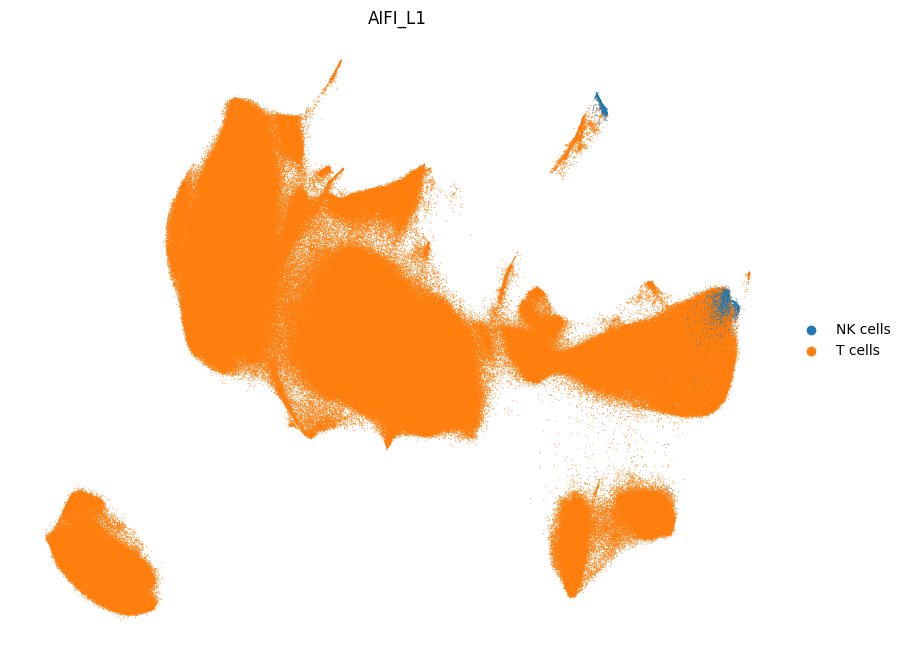

In [216]:
sc.pl.umap(adata, color=['AIFI_L1'], size=2,ncols=1 ,frameon=False)

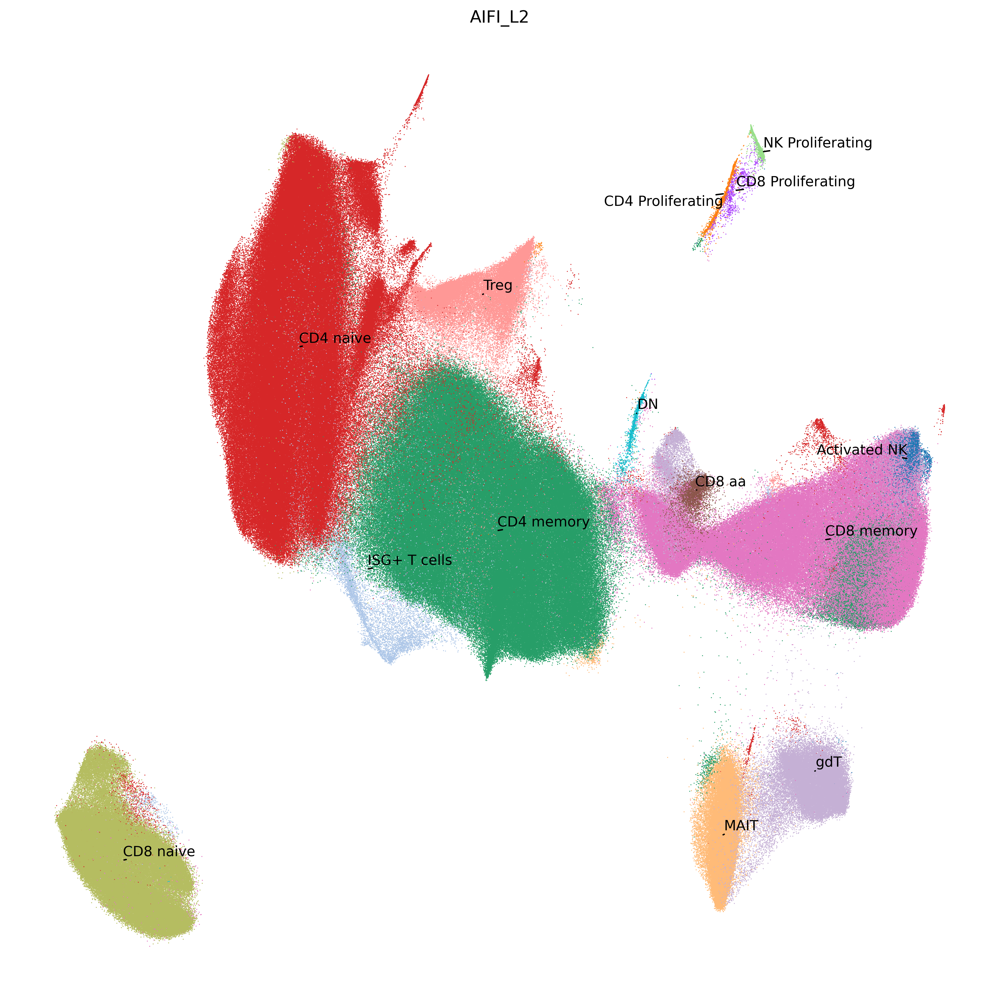

In [217]:
with plt.rc_context({"figure.figsize": (10, 10), "figure.dpi": 500, "figure.frameon": False}):
    ax=sc.pl.umap(adata, color=['AIFI_L2'], size=2,show=False,legend_loc=None,ncols=1 ,frameon=False)
    gen_mpl_labels(
        adata,
        "AIFI_L2",
        exclude=(""),  
        ax=ax,
        adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
        text_kwargs=dict(fontsize=10),)
    fig = ax.get_figure()
    fig.tight_layout()
    #plt.savefig('UMAP.png')

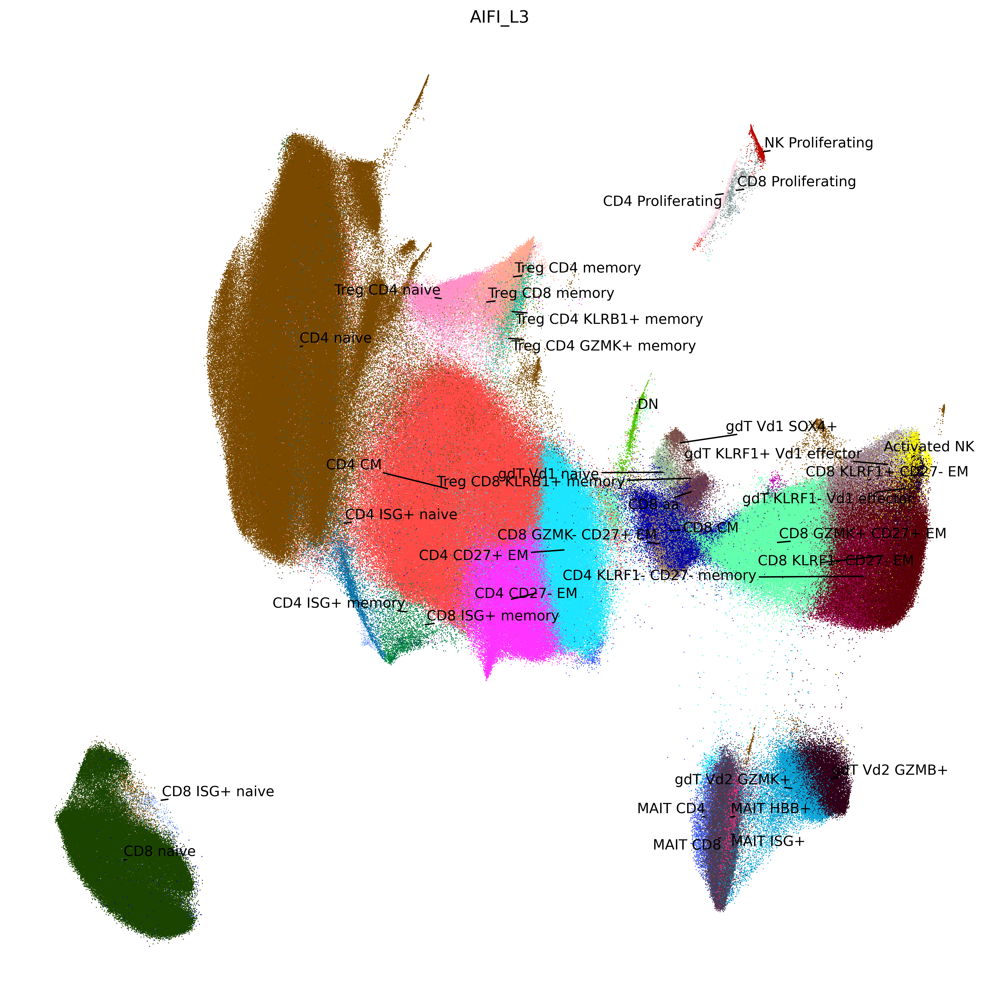

In [218]:
with plt.rc_context({"figure.figsize": (10, 10), "figure.dpi": 500, "figure.frameon": False}):
    ax=sc.pl.umap(adata, color=['AIFI_L3'], size=2,show=False,legend_loc=None,ncols=1 ,frameon=False)
    gen_mpl_labels(
        adata,
        "AIFI_L3",
        exclude=(""),  
        ax=ax,
        adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
        text_kwargs=dict(fontsize=10),)
    fig = ax.get_figure()
    fig.tight_layout()
    #plt.savefig('UMAP.png')

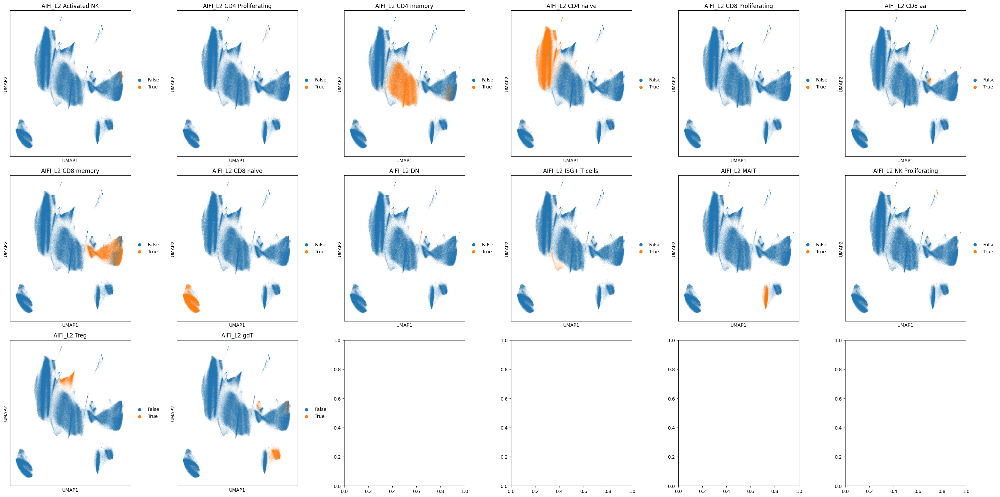

In [219]:
AIFI_L2_categories = adata.obs['AIFI_L2'].cat.categories

n_categories = len(AIFI_L2_categories)

n_columns = 6 
n_rows = math.ceil(n_categories / n_columns)

fig, axs = plt.subplots(n_rows, n_columns, figsize=(5 * n_columns, 5 * n_rows))

for i, category in enumerate(AIFI_L2_categories):
    row = i // n_columns
    col = i % n_columns
    adata.obs['cluster_dummy'] = adata.obs['AIFI_L2'] == category
    adata.obs['cluster_dummy']=[str(item) for item in adata.obs['cluster_dummy']]
    sc.pl.umap(adata, color='cluster_dummy', title=f'AIFI_L2 {category}', ax=axs[row, col], show=False)

plt.tight_layout()
plt.show()

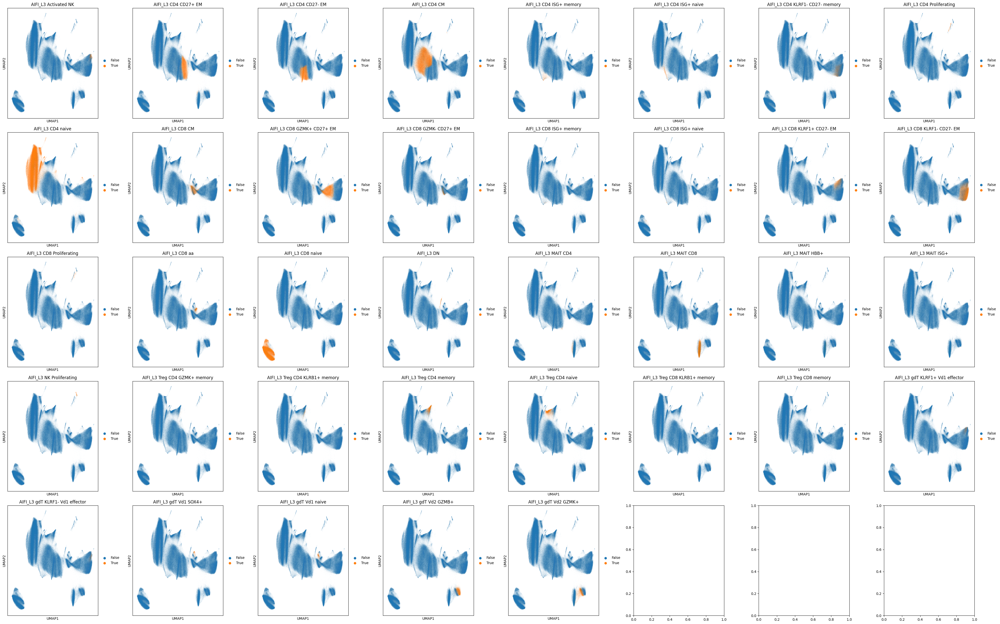

In [220]:
AIFI_L3_categories = adata.obs['AIFI_L3'].cat.categories

n_categories = len(AIFI_L3_categories)

n_columns = 8
n_rows = math.ceil(n_categories / n_columns)

fig, axs = plt.subplots(n_rows, n_columns, figsize=(5 * n_columns, 5 * n_rows))

for i, category in enumerate(AIFI_L3_categories):
    row = i // n_columns
    col = i % n_columns
    adata.obs['cluster_dummy'] = adata.obs['AIFI_L3'] == category
    adata.obs['cluster_dummy']=[str(item) for item in adata.obs['cluster_dummy']]
    sc.pl.umap(adata, color='cluster_dummy', title=f'AIFI_L3 {category}', ax=axs[row, col], show=False)

plt.tight_layout()
plt.show()

In [221]:
T_gene_of_interests = "CD3E, CD4, CD8A, TRAC, TRDC, LEF1, TCF7, CCR7, SELL, ITGB1, FAS, CD27, CD28, FOXP3, RTKN2, IKZF2, ZNF683, NKG7, KLRC2, KLRF1, KLRB1, KLRD1, GZMA, GZMK, GZMB, PRF1, GNLY, IFI44L, IRF7, MKI67, TRDV1, TRDV2, TRDV3, MME, SOX4"

In [222]:
T_gene_of_interests = T_gene_of_interests.split(', ')

In [223]:
adata=adata.raw.to_adata()
adata.raw=adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

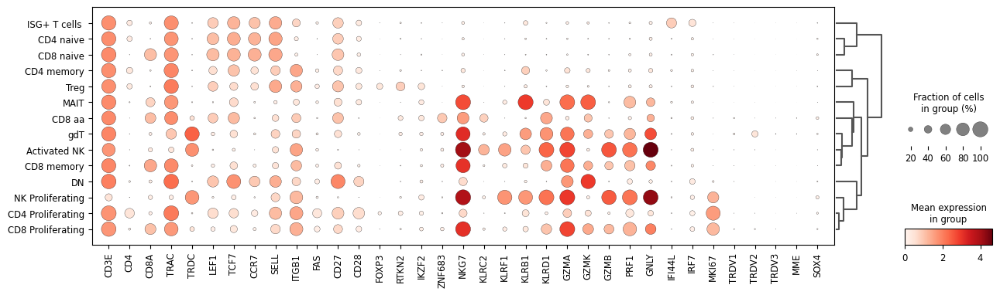

In [224]:
dp = sc.pl.dotplot(adata, T_gene_of_interests, 'AIFI_L2', use_raw=False, dendrogram=True,figsize=(15,4),return_fig=True)
dp.show()

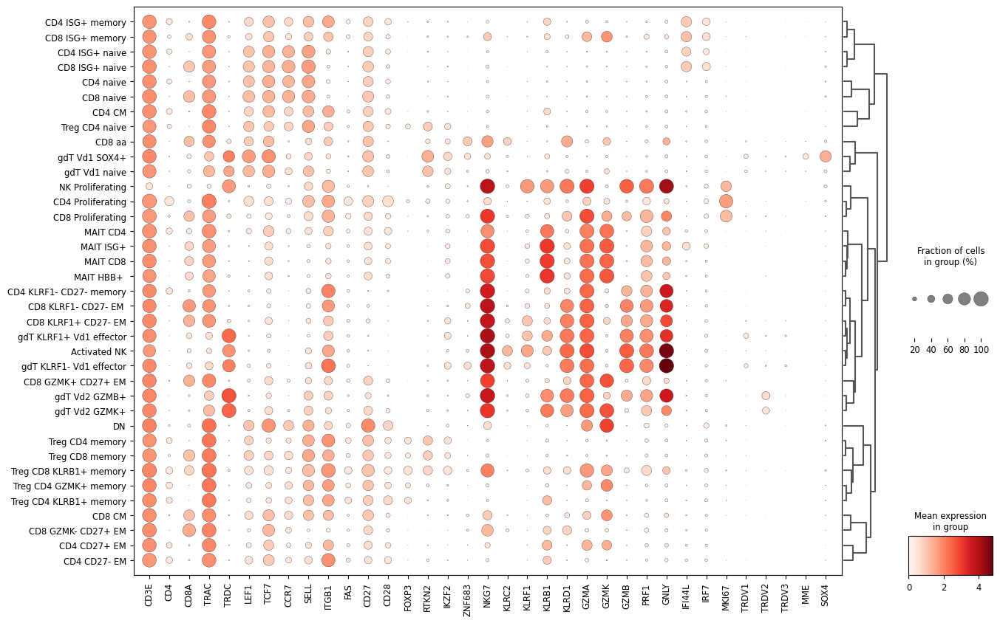

In [225]:
dp = sc.pl.dotplot(adata, T_gene_of_interests, 'AIFI_L3', use_raw=False, dendrogram=True,figsize=(15,10),return_fig=True)
dp.show()

In [226]:
data=adata.obs[['AIFI_L1','AIFI_L2','AIFI_L3']]
df = pd.DataFrame(data)

# Creating the nested dictionary
nested_dict = {}
for key1, group1 in df.groupby('AIFI_L1'):
    nested_dict[key1] = {key2: group2['AIFI_L3'].unique().tolist() for key2, group2 in group1.groupby('AIFI_L2') if not group2['AIFI_L2'].empty}

nested_dict


{'NK cells': {'Activated NK': ['Activated NK'],
  'NK Proliferating': ['NK Proliferating']},
 'T cells': {'CD4 Proliferating': ['CD4 Proliferating'],
  'CD4 memory': ['CD4 CM',
   'CD4 CD27+ EM',
   'CD4 CD27- EM',
   'CD4 KLRF1- CD27- memory'],
  'CD4 naive': ['CD4 naive'],
  'CD8 Proliferating': ['CD8 Proliferating'],
  'CD8 aa': ['CD8 aa'],
  'CD8 memory': ['CD8 GZMK+ CD27+ EM',
   'CD8 CM',
   'CD8 KLRF1- CD27- EM ',
   'CD8 GZMK- CD27+ EM',
   'CD8 KLRF1+ CD27- EM'],
  'CD8 naive': ['CD8 naive'],
  'DN': ['DN'],
  'ISG+ T cells ': ['CD4 ISG+ memory',
   'CD4 ISG+ naive',
   'CD8 ISG+ naive',
   'CD8 ISG+ memory'],
  'MAIT': ['MAIT CD8', 'MAIT CD4', 'MAIT HBB+ ', 'MAIT ISG+'],
  'Treg': ['Treg CD4 naive',
   'Treg CD4 memory',
   'Treg CD4 KLRB1+ memory',
   'Treg CD8 memory',
   'Treg CD4 GZMK+ memory',
   'Treg CD8 KLRB1+ memory'],
  'gdT': ['gdT Vd2 GZMK+',
   'gdT Vd2 GZMB+',
   'gdT Vd1 naive',
   'gdT KLRF1+ Vd1 effector',
   'gdT Vd1 SOX4+',
   'gdT KLRF1- Vd1 effector']}}

In [227]:
import pandas as pd

def create_dataframe_for_sunburst_single_hyphen(nested_dict):
    rows = []
    for parent, children in nested_dict.items():
        # Add the parent as the first level
        rows.append({"ids": parent, "labels": parent, "parents": pd.NA})
        for child, grand_children in children.items():
            child_id = f"{parent}-{child}"
            rows.append({"ids": child_id, "labels": child, "parents": parent})
            for grand_child in grand_children:
                grand_child_id = f"{child_id}-{grand_child}"
                rows.append({"ids": grand_child_id, "labels": grand_child, "parents": child_id})
    return pd.DataFrame(rows)


In [228]:
df_sunburst_single_hyphen = create_dataframe_for_sunburst_single_hyphen(nested_dict)


In [229]:
df_sunburst_single_hyphen=df_sunburst_single_hyphen[0:3]

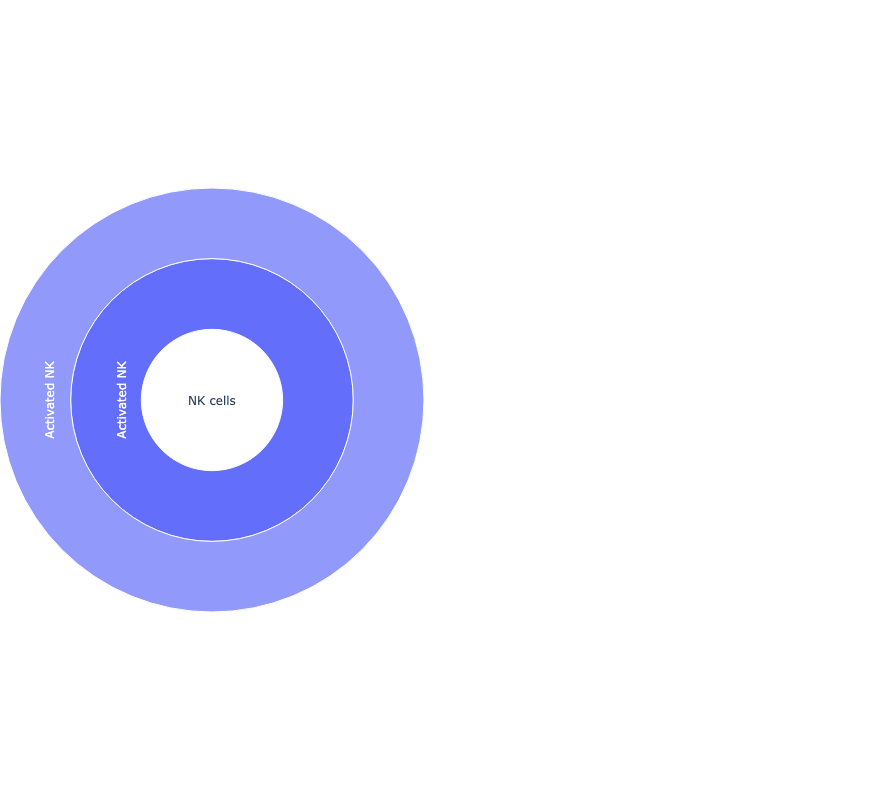

'AIFI.html'

In [230]:
fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=df_sunburst_single_hyphen.ids,
    labels=df_sunburst_single_hyphen.labels,
    parents=df_sunburst_single_hyphen.parents,
    domain=dict(column=0),      
))


fig.update_layout(
    grid= dict(columns=2, rows=1),
    margin = dict(t=0, l=0, r=0, b=0)
)
fig.update_layout(width=800, height=800)
fig.show()
plotly.offline.plot(fig, filename='AIFI.html')

In [231]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches


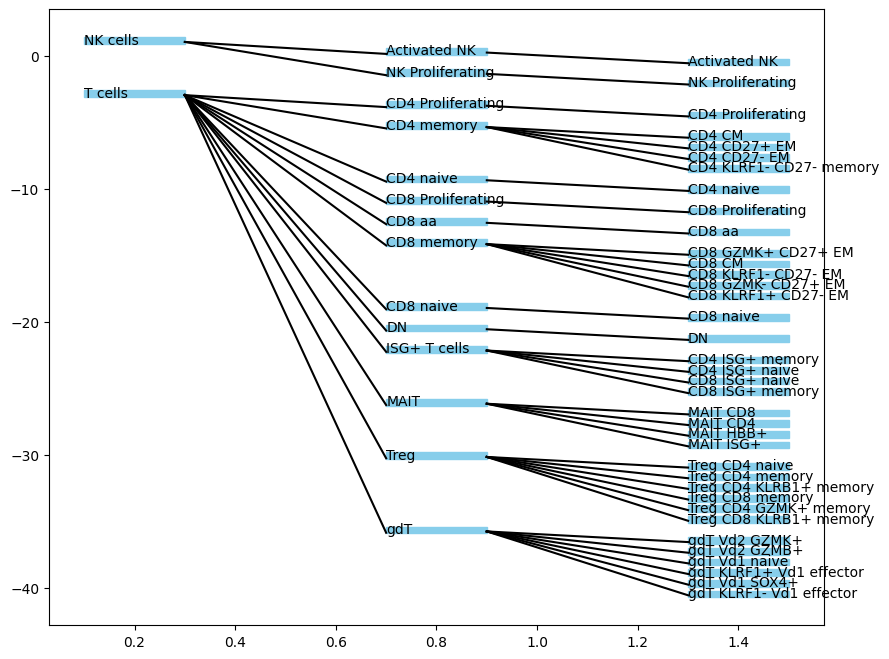

In [232]:
plt.rcParams['figure.figsize'] = [10, 8]
fig, ax = plt.subplots()
data=nested_dict
# Function to draw a node (rectangle + text)
def draw_node(x, y, text, ax):
    ax.add_patch(mpatches.Rectangle((x, y), 0.2, 0.5, fill=True, color='skyblue'))
    plt.text(x , y , text,  )

# Starting positions
x = 0.1
y = 0.9

# Vertical spacing and horizontal spacing
v_space = 0.8
h_space = 0.6

for parent, children in data.items():
    parent_y = y
    draw_node(x, parent_y, parent, ax)
    y -= v_space  # Move down for children
    child_x = x + h_space  # Move right for children
    
    for child, subchildren in children.items():
        child_y = y
        draw_node(child_x, child_y, child, ax)
        # Draw line from parent to child
        plt.plot([x + 0.2, child_x], [parent_y + 0.15, child_y + 0.05], 'k-')
        
        y -= v_space  # Move down for next child

        # Drawing subchildren, if any
        subchild_x = child_x + h_space
        for subchild in subchildren:
            draw_node(subchild_x, y, subchild, ax)
            # Draw line from child to subchild
            plt.plot([child_x + 0.2, subchild_x], [child_y + 0.15, y + 0.15], 'k-')
            y -= v_space  # Move down for next subchild

# Set limits and turn off axis


plt.show()

In [233]:
adata.write_h5ad('T_Labeled.h5ad')

In [234]:
adata_NK=sc.read_h5ad('/home/jupyter/reference_generating_new/NK_construction/NK_Labeled.h5ad')

In [235]:
NK_T_adata=anndata.concat([adata, adata_NK])

In [236]:
NK_T_gene_of_interests="CD3E, CD4, CD8A, TRAC, TRDC, LEF1, TCF7, CCR7, SELL, ITGB1, FAS, CD27, CD28, FOXP3, RTKN2, IKZF2, ZNF683, NKG7, KLRC2, KLRF1, KLRB1, KLRD1, GZMA, GZMK, GZMB, PRF1, GNLY, IFI44L, IRF7, MKI67, TRDV1, TRDV2, TRDV3, MME, SOX4, NCAM1, FCGR3A, CD3D, KLRC2, KIT"
NK_T_gene_of_interests = NK_T_gene_of_interests.split(', ')

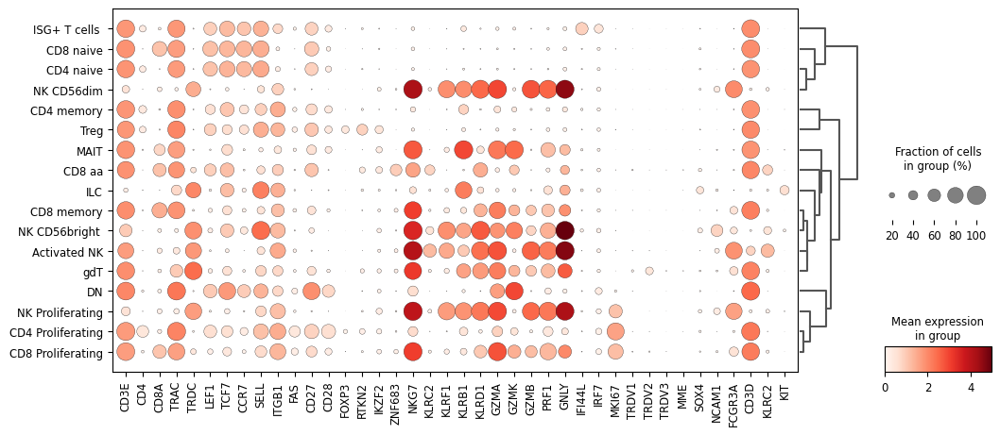

In [237]:
dp = sc.pl.dotplot(NK_T_adata, NK_T_gene_of_interests, 'AIFI_L2', use_raw=False, dendrogram=True,figsize=(12,5),return_fig=True)
dp.show()

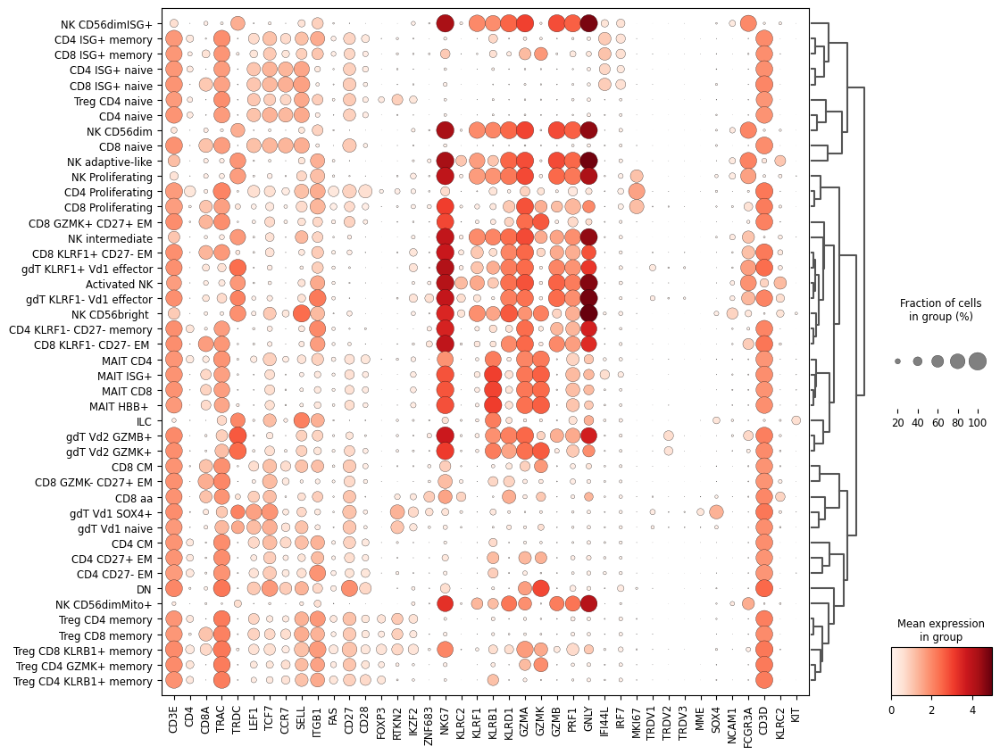

In [238]:
dp = sc.pl.dotplot(NK_T_adata, NK_T_gene_of_interests, 'AIFI_L3', use_raw=False, dendrogram=True,figsize=(12,10),return_fig=True)
dp.show()

In [239]:
data=NK_T_adata.obs[['AIFI_L1','AIFI_L2','AIFI_L3']]
df = pd.DataFrame(data)

# Creating the nested dictionary
nested_dict = {}
for key1, group1 in df.groupby('AIFI_L1'):
    nested_dict[key1] = {key2: group2['AIFI_L3'].unique().tolist() for key2, group2 in group1.groupby('AIFI_L2') if not group2['AIFI_L2'].empty}

nested_dict


{'ILC': {'ILC': ['ILC']},
 'NK cells': {'Activated NK': ['Activated NK'],
  'NK CD56bright ': ['NK CD56bright '],
  'NK CD56dim': ['NK intermediate',
   'NK CD56dim',
   'NK adaptive-like',
   'NK CD56dimISG+',
   'NK CD56dimMito+'],
  'NK Proliferating': ['NK Proliferating']},
 'T cells': {'CD4 Proliferating': ['CD4 Proliferating'],
  'CD4 memory': ['CD4 CM',
   'CD4 CD27+ EM',
   'CD4 CD27- EM',
   'CD4 KLRF1- CD27- memory'],
  'CD4 naive': ['CD4 naive'],
  'CD8 Proliferating': ['CD8 Proliferating'],
  'CD8 aa': ['CD8 aa'],
  'CD8 memory': ['CD8 GZMK+ CD27+ EM',
   'CD8 CM',
   'CD8 KLRF1- CD27- EM ',
   'CD8 GZMK- CD27+ EM',
   'CD8 KLRF1+ CD27- EM'],
  'CD8 naive': ['CD8 naive'],
  'DN': ['DN'],
  'ISG+ T cells ': ['CD4 ISG+ memory',
   'CD4 ISG+ naive',
   'CD8 ISG+ naive',
   'CD8 ISG+ memory'],
  'MAIT': ['MAIT CD8', 'MAIT CD4', 'MAIT HBB+ ', 'MAIT ISG+'],
  'Treg': ['Treg CD4 naive',
   'Treg CD4 memory',
   'Treg CD4 KLRB1+ memory',
   'Treg CD8 memory',
   'Treg CD4 GZMK+ mem

In [240]:
df_sunburst_single_hyphen = create_dataframe_for_sunburst_single_hyphen(nested_dict)


In [ ]:
fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=df_sunburst_single_hyphen.ids,
    labels=df_sunburst_single_hyphen.labels,
    parents=df_sunburst_single_hyphen.parents,
    domain=dict(column=0),      
))


fig.update_layout(
    grid= dict(columns=2, rows=1),
    margin = dict(t=0, l=0, r=0, b=0)
)

fig.show()
#plotly.offline.plot(fig, filename='AIFI.html')